In [1]:
using DifferentialEquations
using Plots


In [27]:
using DifferentialEquations
using Plots
# Parameters
r1 = 0.15
r2 = 0.15
K = 0.1
D = 0.1
λx = 0.4
λy = 0.1
Lx = 400.0
Ly = 300.0

# Grid
Nx = 200
Ny = 150
x = LinRange(0, Lx, Nx)
y = LinRange(0, Ly, Ny)
dx = x[2] - x[1]
dy = y[2] - y[1]

# Initial conditions
# Updated Initial Conditions
function initial_conditions(x, y)
    if Ly-1 <= y <= Ly
        if abs(x - (Lx ÷ 2)) < Lx / 20
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end


# Laplacian with no-flux boundary conditions
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2
    
    # Apply no-flux boundary conditions by setting the outer derivative to zero
    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2
    
    return lx + ly
end

# Partial derivatives with no-flux boundary conditions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    
    # Apply no-flux boundary conditions
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    
    # Apply no-flux boundary conditions
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    
    return du
end

# Reaction-diffusion system
function reaction_diffusion!(du, u, p, t)
    n1 = u[1, :, :]
    n2 = u[2, :, :]
    n = n1 .+ n2
    f = n1 ./ (n .+ 1e-5)
    
    du[1, :, :] .= r1 .* (1 .+ 3 .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                   0.0 * λx .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
    du[2, :, :] .= r2 .* (1 .+ 3 .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                   λx .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
end

# Initial conditions
u0 = zeros(2, Ny, Nx)
for i in 1:Nx
    for j in 1:Ny
        n1, n2 = initial_conditions(x[i], y[j])
        u0[1, j, i] = n1
        u0[2, j, i] = n2
    end
end

# Time span
tspan = (0.0, 1430.0)

# PDE problem
prob = ODEProblem(reaction_diffusion!, u0, tspan)

# Solve
sol = solve(prob, Tsit5(); saveat=tspan[2]);


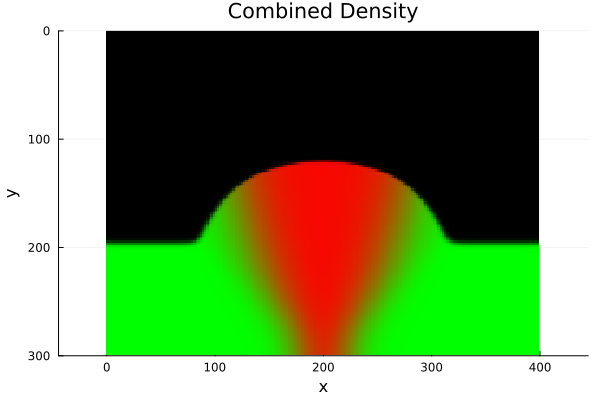

In [28]:
using Colors

# Calculate the fraction of type 1
f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Add a small value to avoid division by zero

# Calculate the total density
total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

# Create the colormap
function create_colormap(f1, total_density)
    colormap = [RGB(f1[i, j], 1-f1[i, j], 0) * total_density[i, j] for i in 1:size(f1, 1), j in 1:size(f1, 2)]
    return colormap
end

# Generate the colormap
colormap = create_colormap(f1, total_density)

# Plot the heatmap
heatmap(x, y, colormap, title="Combined Density", xlabel="x", ylabel="y", color=:auto)


In [4]:
GC.gc()

0.00.0
0.00.2
0.00.4
0.00.6
0.00.8
0.01.0
0.20.0
0.20.2
0.20.4
0.20.6
0.20.8
0.21.0
0.40.0
0.40.2
0.40.4
0.40.6
0.40.8
0.41.0
0.60.0
0.60.2
0.60.4
0.60.6
0.60.8
0.61.0
0.80.0
0.80.2
0.80.4
0.80.6
0.80.8
0.81.0
1.00.0
1.00.2
1.00.4
1.00.6
1.00.8
1.01.0


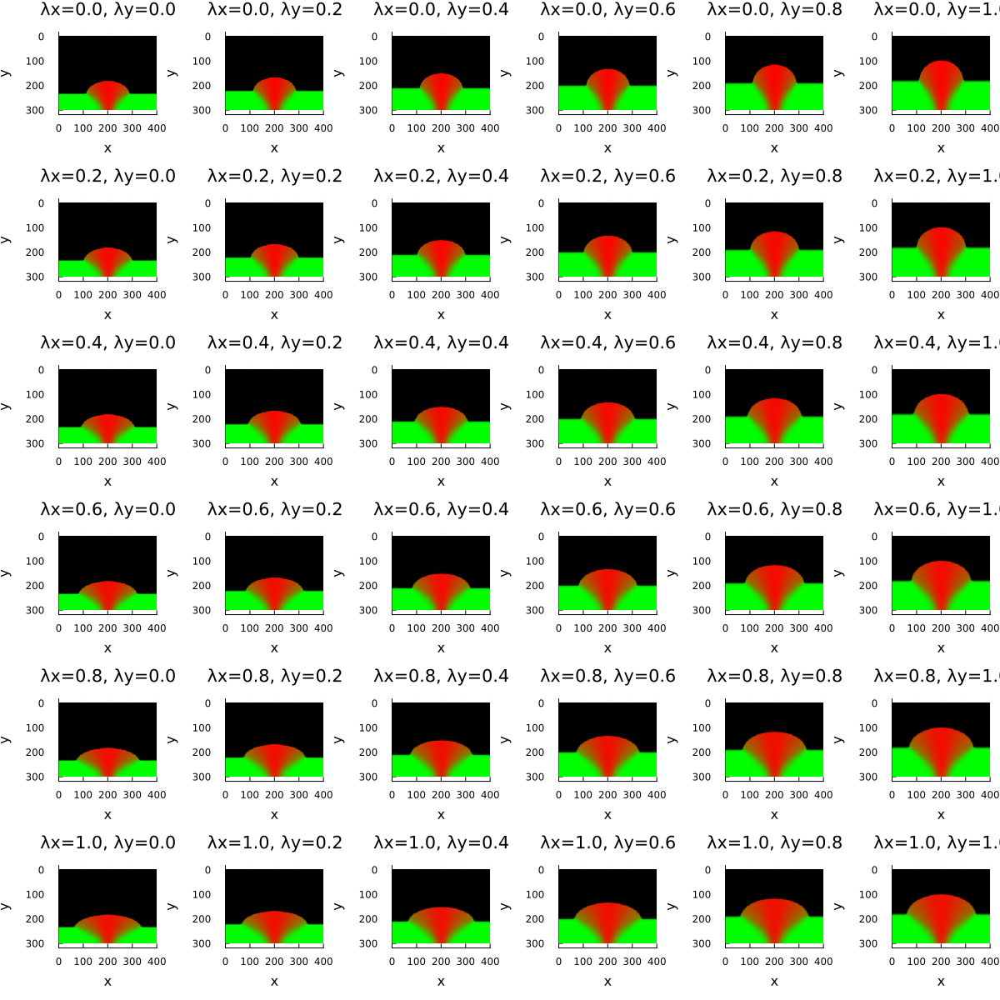

In [54]:
using DifferentialEquations
using Plots
using Colors

# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if Ly-1 <= y <= Ly
        if abs(x - (Lx ÷ 2)) < Lx / 20
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end

# Laplacian with no-flux boundary conditions
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2
    
    # Apply no-flux boundary conditions by setting the outer derivative to zero
    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2
    
    return lx + ly
end

# Partial derivatives with no-flux boundary conditions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    
    # Apply no-flux boundary conditions
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    
    # Apply no-flux boundary conditions
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    
    return du
end

# Reaction-diffusion system
function reaction_diffusion!(du, u, p, t)
    r1, r2, K, D, λx, λy, dx, dy = p
    n1 = u[1, :, :]
    n2 = u[2, :, :]
    n = n1 .+ n2
    f = n1 ./ (n .+ 1e-5)  
    
    du[1, :, :] .= r1 .* (1 .+ 3 .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                   1.0 * λx .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
    du[2, :, :] .= r2 .* (1 .+ 3 .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                   λx .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
end

# Sweep ranges for λx and λy
λx_vals = 0.0:0.2:1.0
λy_vals = 0.0:0.2:1.0

# Parameters
r1 = 0.15
r2 = 0.15
K = 0.1
D = 0.1
Lx = 400.0
Ly = 300.0

# Grid
Nx = 200
Ny = 150
x = LinRange(0, Lx, Nx)
y = LinRange(0, Ly, Ny)
dx = x[2] - x[1]
dy = y[2] - y[1]


# Collect plots
plots = []

# Run simulations for each combination of λx and λy and plot the results
for λx in λx_vals
    for λy in λy_vals
        println(λx, λy)
        # Initial conditions
        u0 = zeros(2, Ny, Nx)
        for ix in 1:Nx
            for iy in 1:Ny
                n1, n2 = initial_conditions(x[ix], y[iy], Lx, Ly)
                u0[1, iy, ix] = n1
                u0[2, iy, ix] = n2
            end
        end
        
        # Time span
        tspan = (0.0, 1000.0)

        # Parameters for the current simulation
        params = (r1, r2, K, D, λx, λy, dx, dy)

        # PDE problem with current λx and λy
        prob = ODEProblem(reaction_diffusion!, u0, tspan, params)

        # Solve
        sol = solve(prob, Tsit5(); saveat=tspan[2])

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Add a small value to avoid division by zero

        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = [RGB(f1[k, l], 1-f1[k, l], 0) * total_density[k, l] for k in 1:size(f1, 1), l in 1:size(f1, 2)]

        # Generate the heatmap for this combination
        push!(plots, heatmap(x, y, colormap, title="λx=$λx, λy=$λy", xlabel="x", ylabel="y", color=:auto))
    end
end

# Display the grid of plots
plot(plots..., layout=(length(λx_vals), length(λy_vals)), size=(1200, 1200))


0.00.0
0.00.2
0.00.4
0.00.6
0.00.8
0.01.0
0.20.0
0.20.2
0.20.4
0.20.6
0.20.8
0.21.0
0.40.0
0.40.2
0.40.4
0.40.6
0.40.8
0.41.0
0.60.0
0.60.2
0.60.4
0.60.6
0.60.8
0.61.0
0.80.0
0.80.2
0.80.4
0.80.6
0.80.8
0.81.0
1.00.0
1.00.2
1.00.4
1.00.6
1.00.8
1.01.0


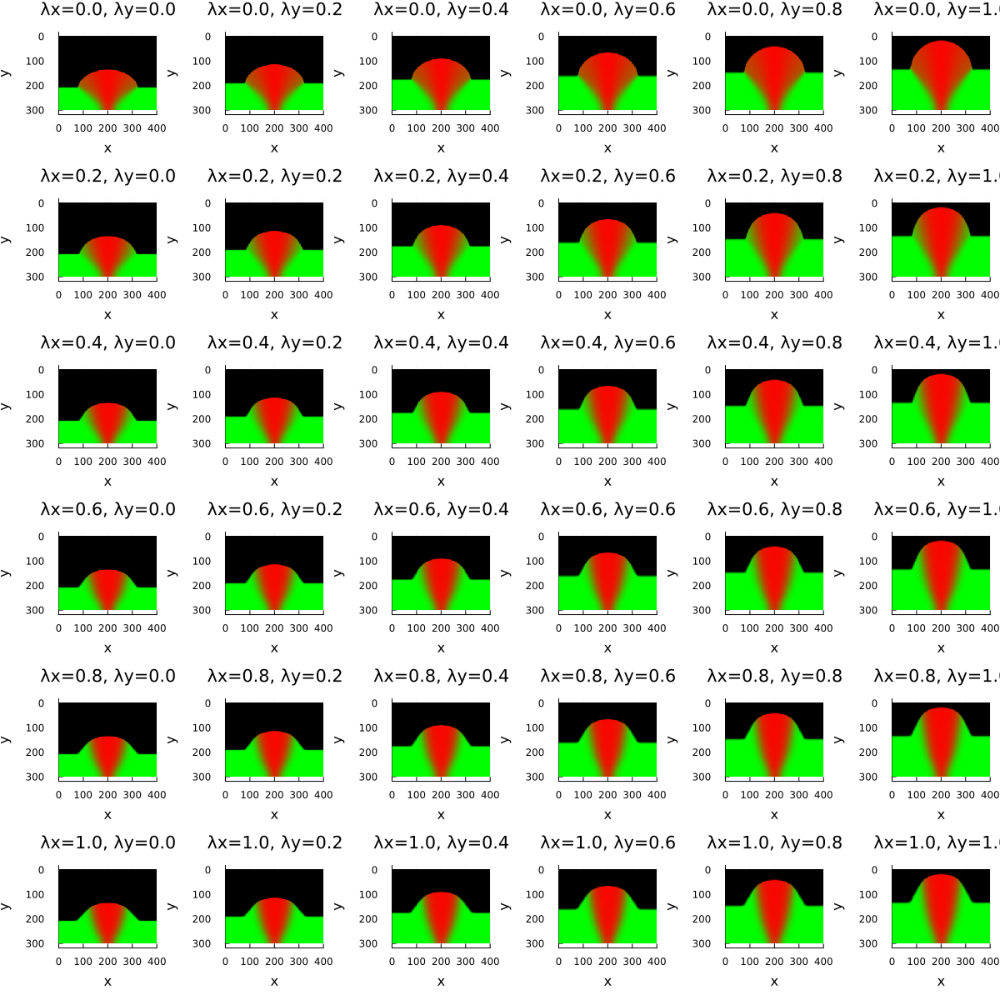

In [2]:
using DifferentialEquations
using Plots
using Colors

# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if Ly-1 <= y <= Ly
        if abs(x - (Lx ÷ 2)) < Lx / 20
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end

# Laplacian with no-flux boundary conditions
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2
    
    # Apply no-flux boundary conditions by setting the outer derivative to zero
    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2
    
    return lx + ly
end

# Partial derivatives with no-flux boundary conditions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    
    # Apply no-flux boundary conditions
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    
    # Apply no-flux boundary conditions
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    
    return du
end

# Reaction-diffusion system
function reaction_diffusion!(du, u, p, t)
    r1, r2, K, D, λx, λy, dx, dy = p
    n1 = u[1, :, :]
    n2 = u[2, :, :]
    n = n1 .+ n2
    f = n1 ./ (n .+ 1e-5)  
    
    du[1, :, :] .= r1 .* (1 .+ 3 .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                   0.0 * λx .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
    du[2, :, :] .= r2 .* (1 .+ 3 .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                   λx .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
end

# Sweep ranges for λx and λy
λx_vals = 0.0:0.2:1.0
λy_vals = 0.0:0.2:1.0

# Parameters
r1 = 0.15
r2 = 0.15
K = 0.1
D = 0.1
Lx = 400.0
Ly = 300.0

# Grid
Nx = 200
Ny = 150
x = LinRange(0, Lx, Nx)
y = LinRange(0, Ly, Ny)
dx = x[2] - x[1]
dy = y[2] - y[1]


# Collect plots
plots = []

# Run simulations for each combination of λx and λy and plot the results
for λx in λx_vals
    for λy in λy_vals
        println(λx, λy)
        # Initial conditions
        u0 = zeros(2, Ny, Nx)
        for ix in 1:Nx
            for iy in 1:Ny
                n1, n2 = initial_conditions(x[ix], y[iy], Lx, Ly)
                u0[1, iy, ix] = n1
                u0[2, iy, ix] = n2
            end
        end
        
        # Time span
        tspan = (0.0, 1400.0)

        # Parameters for the current simulation
        params = (r1, r2, K, D, λx, λy, dx, dy)

        # PDE problem with current λx and λy
        prob = ODEProblem(reaction_diffusion!, u0, tspan, params)

        # Solve
        sol = solve(prob, Tsit5(); saveat=tspan[2])

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Add a small value to avoid division by zero

        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = [RGB(f1[k, l], 1-f1[k, l], 0) * total_density[k, l] for k in 1:size(f1, 1), l in 1:size(f1, 2)]

        # Generate the heatmap for this combination
        push!(plots, heatmap(x, y, colormap, title="λx=$λx, λy=$λy", xlabel="x", ylabel="y", color=:auto))
    end
end

# Display the grid of plots
plot(plots..., layout=(length(λx_vals), length(λy_vals)), size=(1200, 1200))


0.00.0
0.00.2
0.00.4
0.00.6
0.00.8
0.01.0
0.20.0
0.20.2
0.20.4
0.20.6
0.20.8
0.21.0
0.40.0
0.40.2
0.40.4
0.40.6
0.40.8
0.41.0
0.60.0
0.60.2
0.60.4
0.60.6
0.60.8
0.61.0
0.80.0
0.80.2
0.80.4
0.80.6
0.80.8
0.81.0
1.00.0
1.00.2
1.00.4
1.00.6
1.00.8
1.01.0


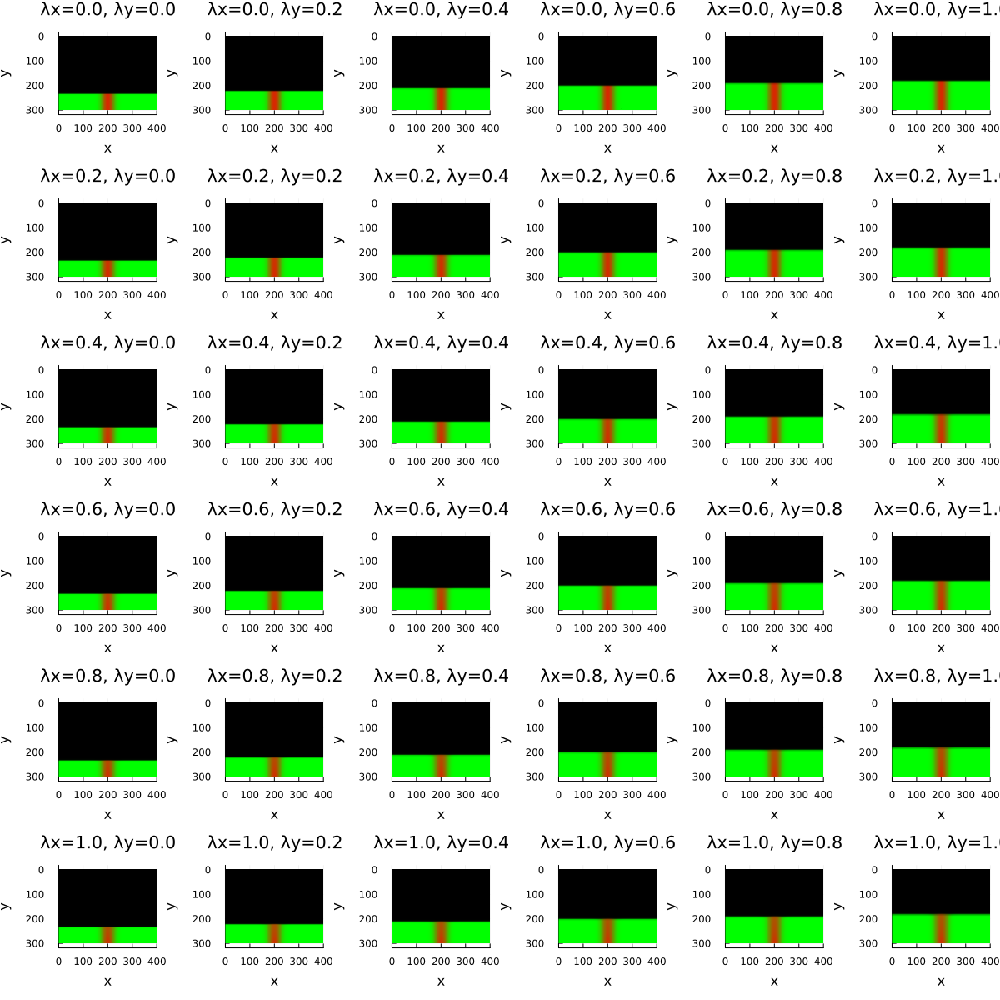

In [4]:
using DifferentialEquations
using Plots
using Colors

# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if Ly-1 <= y <= Ly
        if abs(x - (Lx ÷ 2)) < Lx / 20
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end

# Laplacian with no-flux boundary conditions
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2
    
    # Apply no-flux boundary conditions by setting the outer derivative to zero
    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2
    
    return lx + ly
end

# Partial derivatives with no-flux boundary conditions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    
    # Apply no-flux boundary conditions
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    
    # Apply no-flux boundary conditions
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    
    return du
end

# Reaction-diffusion system
function reaction_diffusion!(du, u, p, t)
    r1, r2, K, D, λx, λy, dx, dy = p
    n1 = u[1, :, :]
    n2 = u[2, :, :]
    n = n1 .+ n2
    f = n1 ./ (n .+ 1e-5)  
    
    du[1, :, :] .= r1 .* (1 .+ 0 .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                   0.0 * λx .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
    du[2, :, :] .= r2 .* (1 .+ 0 .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                   λx .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
end

# Sweep ranges for λx and λy
λx_vals = 0.0:0.2:1.0
λy_vals = 0.0:0.2:1.0

# Parameters
r1 = 0.15
r2 = 0.15
K = 0.1
D = 0.1
Lx = 400.0
Ly = 300.0

# Grid
Nx = 200
Ny = 150
x = LinRange(0, Lx, Nx)
y = LinRange(0, Ly, Ny)
dx = x[2] - x[1]
dy = y[2] - y[1]


# Collect plots
plots = []

# Run simulations for each combination of λx and λy and plot the results
for λx in λx_vals
    for λy in λy_vals
        println(λx, λy)
        # Initial conditions
        u0 = zeros(2, Ny, Nx)
        for ix in 1:Nx
            for iy in 1:Ny
                n1, n2 = initial_conditions(x[ix], y[iy], Lx, Ly)
                u0[1, iy, ix] = n1
                u0[2, iy, ix] = n2
            end
        end
        
        # Time span
        tspan = (0.0, 1000.0)

        # Parameters for the current simulation
        params = (r1, r2, K, D, λx, λy, dx, dy)

        # PDE problem with current λx and λy
        prob = ODEProblem(reaction_diffusion!, u0, tspan, params)

        # Solve
        sol = solve(prob, Tsit5(); saveat=tspan[2])

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Add a small value to avoid division by zero

        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = [RGB(f1[k, l], 1-f1[k, l], 0) * total_density[k, l] for k in 1:size(f1, 1), l in 1:size(f1, 2)]

        # Generate the heatmap for this combination
        push!(plots, heatmap(x, y, colormap, title="λx=$λx, λy=$λy", xlabel="x", ylabel="y", color=:auto))
    end
end

# Display the grid of plots
plot(plots..., layout=(length(λx_vals), length(λy_vals)), size=(1200, 1200))


0.00.0
0.00.2
0.00.4
0.00.6
0.00.8
0.01.0
0.20.0
0.20.2
0.20.4
0.20.6
0.20.8
0.21.0
0.40.0
0.40.2
0.40.4
0.40.6
0.40.8
0.41.0
0.60.0
0.60.2
0.60.4
0.60.6
0.60.8
0.61.0
0.80.0
0.80.2
0.80.4
0.80.6
0.80.8
0.81.0
1.00.0
1.00.2
1.00.4
1.00.6
1.00.8
1.01.0


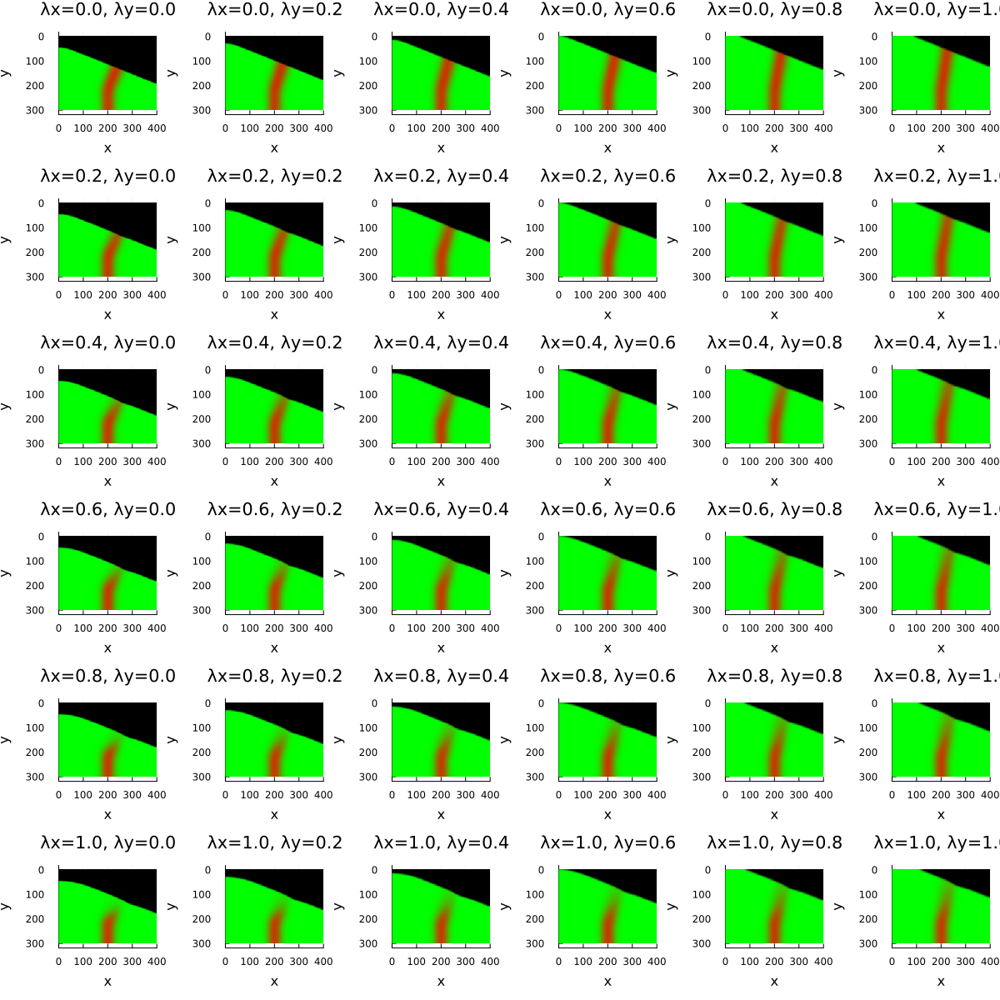

In [1]:
using DifferentialEquations
using Plots
using Colors

# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if y - 0.4 * x > Ly * 4/9
        if abs(x - (Lx ÷ 2)) < Lx / 20
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end

# Laplacian with no-flux boundary conditions
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2
    
    # Apply no-flux boundary conditions by setting the outer derivative to zero
    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2
    
    return lx + ly
end

# Partial derivatives with no-flux boundary conditions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    
    # Apply no-flux boundary conditions
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    
    # Apply no-flux boundary conditions
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    
    return du
end

# Reaction-diffusion system
function reaction_diffusion!(du, u, p, t)
    r1, r2, K, D, λx, λy, dx, dy = p
    n1 = u[1, :, :]
    n2 = u[2, :, :]
    n = n1 .+ n2
    f = n1 ./ (n .+ 1e-5)  
    
    du[1, :, :] .= r1 .* (1 .+ 0 .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                   0.0 * λx .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
    du[2, :, :] .= r2 .* (1 .+ 0 .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                   λx .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
end

# Sweep ranges for λx and λy
λx_vals = 0.0:0.2:1.0
λy_vals = 0.0:0.2:1.0

# Parameters
r1 = 0.15
r2 = 0.15
K = 0.1
D = 0.1
Lx = 400.0
Ly = 300.0

# Grid
Nx = 200
Ny = 150
x = LinRange(0, Lx, Nx)
y = LinRange(0, Ly, Ny)
dx = x[2] - x[1]
dy = y[2] - y[1]


# Collect plots
plots = []

# Run simulations for each combination of λx and λy and plot the results
for λx in λx_vals
    for λy in λy_vals
        println(λx, λy)
        # Initial conditions
        u0 = zeros(2, Ny, Nx)
        for ix in 1:Nx
            for iy in 1:Ny
                n1, n2 = initial_conditions(x[ix], y[iy], Lx, Ly)
                u0[1, iy, ix] = n1
                u0[2, iy, ix] = n2
            end
        end
        
        # Time span
        tspan = (0.0, 1400.0)

        # Parameters for the current simulation
        params = (r1, r2, K, D, λx, λy, dx, dy)

        # PDE problem with current λx and λy
        prob = ODEProblem(reaction_diffusion!, u0, tspan, params)

        # Solve
        sol = solve(prob, Tsit5(); saveat=tspan[2])

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Add a small value to avoid division by zero

        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = [RGB(f1[k, l], 1-f1[k, l], 0) * total_density[k, l] for k in 1:size(f1, 1), l in 1:size(f1, 2)]

        # Generate the heatmap for this combination
        push!(plots, heatmap(x, y, colormap, title="λx=$λx, λy=$λy", xlabel="x", ylabel="y", color=:auto))
    end
end

# Display the grid of plots
plot(plots..., layout=(length(λx_vals), length(λy_vals)), size=(1200, 1200))


0.00.0
0.00.2
0.00.4
0.00.6
0.00.8
0.01.0
0.20.0
0.20.2
0.20.4
0.20.6
0.20.8
0.21.0
0.40.0
0.40.2
0.40.4
0.40.6
0.40.8
0.41.0
0.60.0
0.60.2
0.60.4
0.60.6
0.60.8
0.61.0
0.80.0
0.80.2
0.80.4
0.80.6
0.80.8
0.81.0
1.00.0
1.00.2
1.00.4
1.00.6
1.00.8
1.01.0


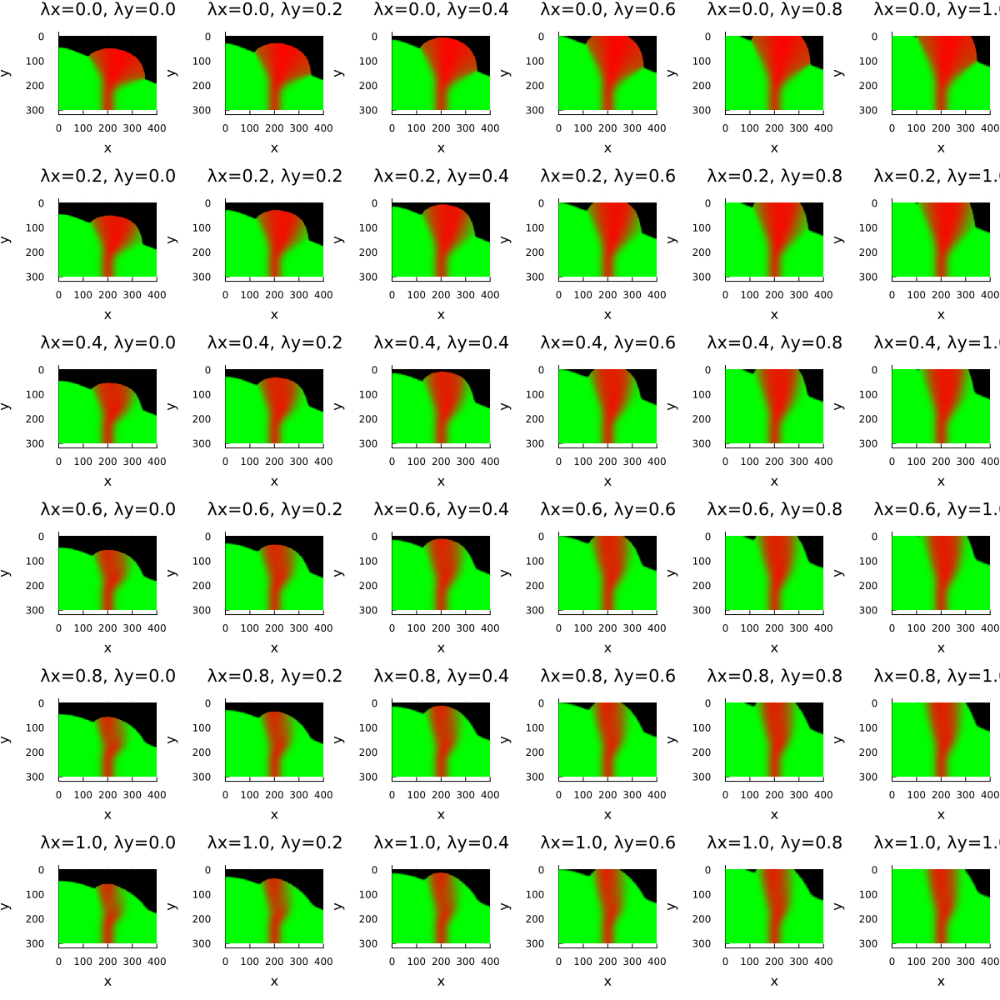

In [29]:
using DifferentialEquations
using Plots
using Colors

# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if y - 0.4 * x > Ly * 4/9
        if abs(x - (Lx ÷ 2)) < Lx / 20
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end

# Laplacian with no-flux boundary conditions
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2
    
    # Apply no-flux boundary conditions by setting the outer derivative to zero
    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2
    
    return lx + ly
end

# Partial derivatives with no-flux boundary conditions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    
    # Apply no-flux boundary conditions
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    
    # Apply no-flux boundary conditions
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    
    return du
end

# Reaction-diffusion system
function reaction_diffusion!(du, u, p, t)
    r1, r2, K, D, λx, λy, dx, dy = p
    n1 = u[1, :, :]
    n2 = u[2, :, :]
    n = n1 .+ n2
    f = n1 ./ (n .+ 1e-5)  
    
    du[1, :, :] .= r1 .* (1 .+ 3.0 .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                   0.0 * λx .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
    du[2, :, :] .= r2 .* (1 .+ 3.0 .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                   λx .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
end

# Sweep ranges for λx and λy
λx_vals = 0.0:0.2:1.0
λy_vals = 0.0:0.2:1.0

# Parameters
r1 = 0.15
r2 = 0.15
K = 0.1
D = 0.1
Lx = 400.0
Ly = 300.0

# Grid
Nx = 200
Ny = 150
x = LinRange(0, Lx, Nx)
y = LinRange(0, Ly, Ny)
dx = x[2] - x[1]
dy = y[2] - y[1]


# Collect plots
plots = []

# Run simulations for each combination of λx and λy and plot the results
for λx in λx_vals
    for λy in λy_vals
        println(λx, λy)
        # Initial conditions
        u0 = zeros(2, Ny, Nx)
        for ix in 1:Nx
            for iy in 1:Ny
                n1, n2 = initial_conditions(x[ix], y[iy], Lx, Ly)
                u0[1, iy, ix] = n1
                u0[2, iy, ix] = n2
            end
        end
        
        # Time span
        tspan = (0.0, 1400.0)

        # Parameters for the current simulation
        params = (r1, r2, K, D, λx, λy, dx, dy)

        # PDE problem with current λx and λy
        prob = ODEProblem(reaction_diffusion!, u0, tspan, params)

        # Solve
        sol = solve(prob, Tsit5(); saveat=tspan[2])

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Add a small value to avoid division by zero

        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = [RGB(f1[k, l], 1-f1[k, l], 0) * total_density[k, l] for k in 1:size(f1, 1), l in 1:size(f1, 2)]

        # Generate the heatmap for this combination
        push!(plots, heatmap(x, y, colormap, title="λx=$λx, λy=$λy", xlabel="x", ylabel="y", color=:auto))
    end
end

# Display the grid of plots
plot(plots..., layout=(length(λx_vals), length(λy_vals)), size=(1200, 1200))


0.00.0
0.00.2
0.00.4
0.00.6
0.00.8
0.01.0
0.20.0
0.20.2
0.20.4
0.20.6
0.20.8
0.21.0
0.40.0
0.40.2
0.40.4
0.40.6
0.40.8
0.41.0
0.60.0
0.60.2
0.60.4
0.60.6
0.60.8
0.61.0
0.80.0
0.80.2
0.80.4
0.80.6
0.80.8
0.81.0
1.00.0
1.00.2
1.00.4
1.00.6
1.00.8
1.01.0


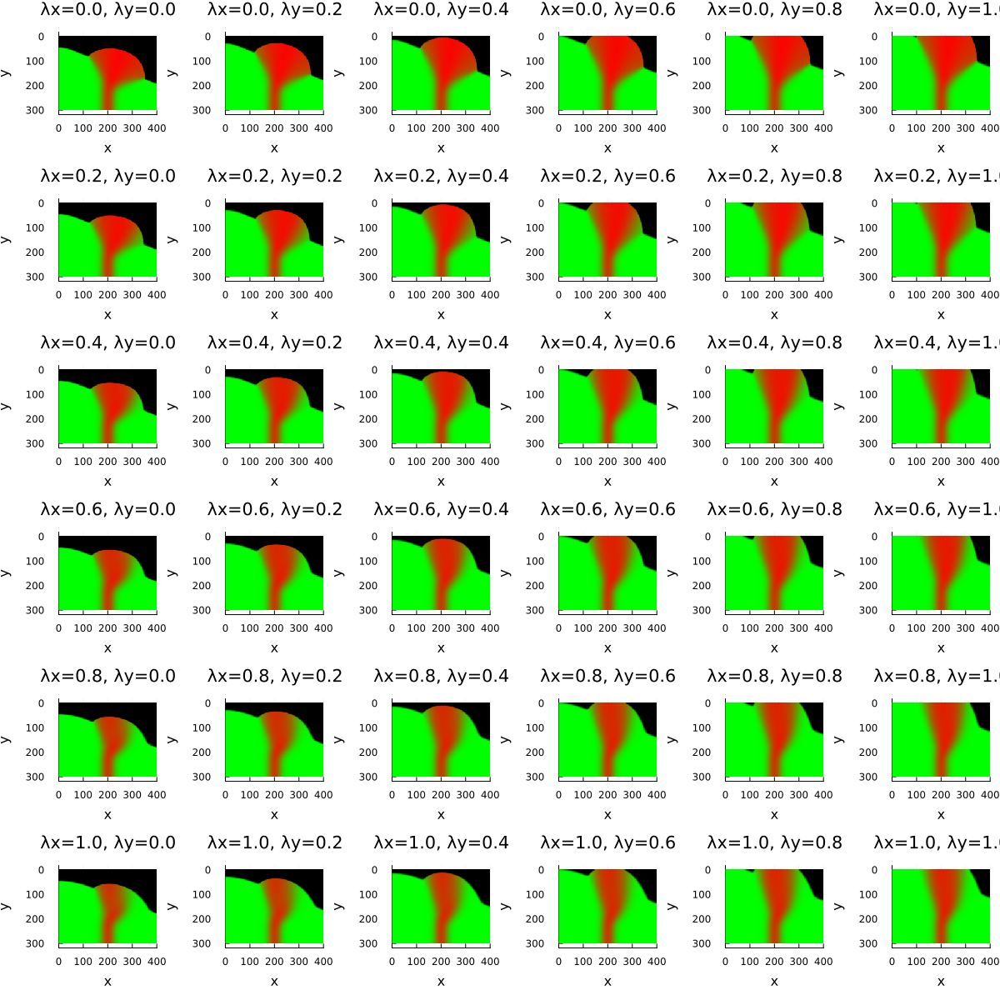

In [30]:
using DifferentialEquations
using Plots
using Colors

# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if y - 0.4 * x > Ly * 4/9
        if abs(x - (Lx ÷ 2)) < Lx / 20
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end

# Laplacian with no-flux boundary conditions
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2
    
    # Apply no-flux boundary conditions by setting the outer derivative to zero
    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2
    
    return lx + ly
end

# Partial derivatives with no-flux boundary conditions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    
    # Apply no-flux boundary conditions
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    
    # Apply no-flux boundary conditions
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    
    return du
end

# Reaction-diffusion system
function reaction_diffusion!(du, u, p, t)
    r1, r2, K, D, λx, λy, dx, dy = p
    n1 = u[1, :, :]
    n2 = u[2, :, :]
    n = n1 .+ n2
    f = n1 ./ (n .+ 1e-5)  
    
    du[1, :, :] .= r1 .* (1 .+ 3.0 .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                   0.2 * λx .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
    du[2, :, :] .= r2 .* (1 .+ 3.0 .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                   λx .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
end

# Sweep ranges for λx and λy
λx_vals = 0.0:0.2:1.0
λy_vals = 0.0:0.2:1.0

# Parameters
r1 = 0.15
r2 = 0.15
K = 0.1
D = 0.1
Lx = 400.0
Ly = 300.0

# Grid
Nx = 200
Ny = 150
x = LinRange(0, Lx, Nx)
y = LinRange(0, Ly, Ny)
dx = x[2] - x[1]
dy = y[2] - y[1]


# Collect plots
plots = []

# Run simulations for each combination of λx and λy and plot the results
for λx in λx_vals
    for λy in λy_vals
        println(λx, λy)
        # Initial conditions
        u0 = zeros(2, Ny, Nx)
        for ix in 1:Nx
            for iy in 1:Ny
                n1, n2 = initial_conditions(x[ix], y[iy], Lx, Ly)
                u0[1, iy, ix] = n1
                u0[2, iy, ix] = n2
            end
        end
        
        # Time span
        tspan = (0.0, 1400.0)

        # Parameters for the current simulation
        params = (r1, r2, K, D, λx, λy, dx, dy)

        # PDE problem with current λx and λy
        prob = ODEProblem(reaction_diffusion!, u0, tspan, params)

        # Solve
        sol = solve(prob, Tsit5(); saveat=tspan[2])

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Add a small value to avoid division by zero

        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = [RGB(f1[k, l], 1-f1[k, l], 0) * total_density[k, l] for k in 1:size(f1, 1), l in 1:size(f1, 2)]

        # Generate the heatmap for this combination
        push!(plots, heatmap(x, y, colormap, title="λx=$λx, λy=$λy", xlabel="x", ylabel="y", color=:auto))
    end
end

# Display the grid of plots
plot(plots..., layout=(length(λx_vals), length(λy_vals)), size=(1200, 1200))


0.00.0
0.00.2
0.00.4
0.00.6
0.00.8
0.01.0
0.20.0
0.20.2
0.20.4
0.20.6
0.20.8
0.21.0
0.40.0
0.40.2
0.40.4
0.40.6
0.40.8
0.41.0
0.60.0
0.60.2
0.60.4
0.60.6
0.60.8
0.61.0
0.80.0
0.80.2
0.80.4
0.80.6
0.80.8
0.81.0
1.00.0
1.00.2
1.00.4
1.00.6
1.00.8
1.01.0


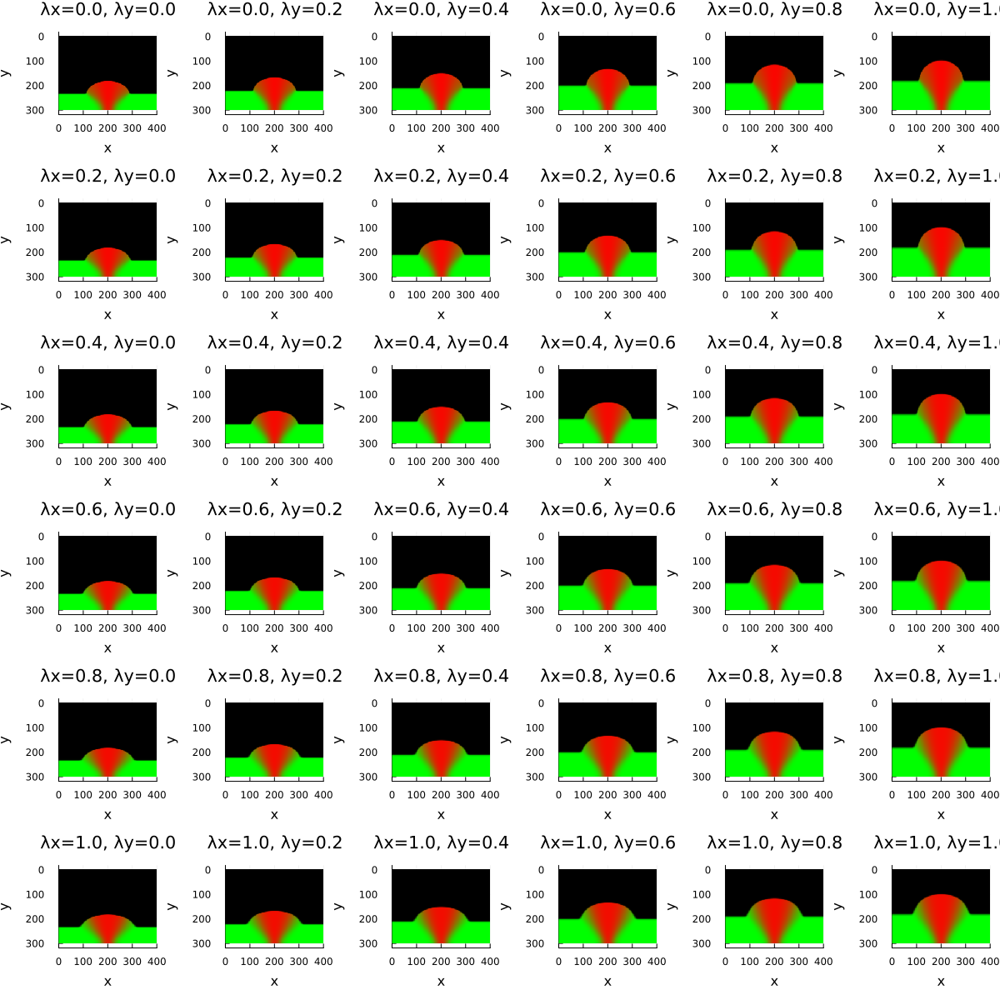

In [2]:
using DifferentialEquations
using Plots
using Colors

# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if Ly-1 <= y <= Ly
        if abs(x - (Lx ÷ 2)) < Lx / 20
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end

# Laplacian with no-flux boundary conditions
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2
    
    # Apply no-flux boundary conditions by setting the outer derivative to zero
    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2
    
    return lx + ly
end

# Partial derivatives with no-flux boundary conditions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    
    # Apply no-flux boundary conditions
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    
    # Apply no-flux boundary conditions
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    
    return du
end

# Reaction-diffusion system
function reaction_diffusion!(du, u, p, t)
    r1, r2, K, D, λx, λy, dx, dy = p
    n1 = u[1, :, :]
    n2 = u[2, :, :]
    n = n1 .+ n2
    f = n1 ./ (n .+ 1e-5)  
    
    du[1, :, :] .= r1 .* (1 .+ 3 .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                   0.5 * λx .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
    du[2, :, :] .= r2 .* (1 .+ 3 .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                   λx .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
end

# Sweep ranges for λx and λy
λx_vals = 0.0:0.2:1.0
λy_vals = 0.0:0.2:1.0

# Parameters
r1 = 0.15
r2 = 0.15
K = 0.1
D = 0.1
Lx = 400.0
Ly = 300.0

# Grid
Nx = 200
Ny = 150
x = LinRange(0, Lx, Nx)
y = LinRange(0, Ly, Ny)
dx = x[2] - x[1]
dy = y[2] - y[1]


# Collect plots
plots = []

# Run simulations for each combination of λx and λy and plot the results
for λx in λx_vals
    for λy in λy_vals
        println(λx, λy)
        # Initial conditions
        u0 = zeros(2, Ny, Nx)
        for ix in 1:Nx
            for iy in 1:Ny
                n1, n2 = initial_conditions(x[ix], y[iy], Lx, Ly)
                u0[1, iy, ix] = n1
                u0[2, iy, ix] = n2
            end
        end
        
        # Time span
        tspan = (0.0, 1000.0)

        # Parameters for the current simulation
        params = (r1, r2, K, D, λx, λy, dx, dy)

        # PDE problem with current λx and λy
        prob = ODEProblem(reaction_diffusion!, u0, tspan, params)

        # Solve
        sol = solve(prob, Tsit5(); saveat=tspan[2])

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Add a small value to avoid division by zero

        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = [RGB(f1[k, l], 1-f1[k, l], 0) * total_density[k, l] for k in 1:size(f1, 1), l in 1:size(f1, 2)]

        # Generate the heatmap for this combination
        push!(plots, heatmap(x, y, colormap, title="λx=$λx, λy=$λy", xlabel="x", ylabel="y", color=:auto))
    end
end

# Display the grid of plots
plot(plots..., layout=(length(λx_vals), length(λy_vals)), size=(1200, 1200))


0.00.0
0.00.2
0.00.4
0.00.6
0.00.8
0.01.0
0.20.0
0.20.2
0.20.4
0.20.6
0.20.8
0.21.0
0.40.0
0.40.2
0.40.4
0.40.6
0.40.8
0.41.0
0.60.0
0.60.2
0.60.4
0.60.6
0.60.8
0.61.0
0.80.0
0.80.2
0.80.4
0.80.6
0.80.8
0.81.0
1.00.0
1.00.2
1.00.4
1.00.6
1.00.8
1.01.0


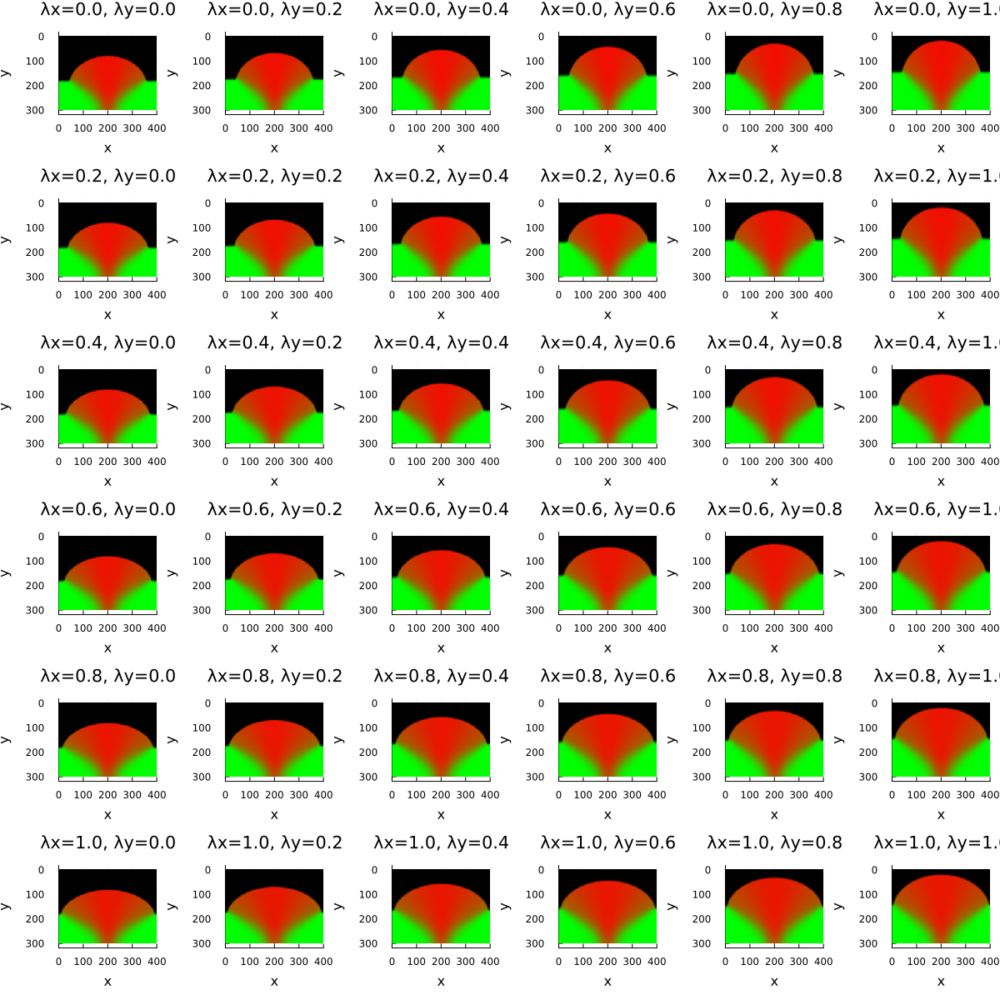

In [3]:
using DifferentialEquations
using Plots
using Colors

# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if Ly-1 <= y <= Ly
        if abs(x - (Lx ÷ 2)) < Lx / 20
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end

# Laplacian with no-flux boundary conditions
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2
    
    # Apply no-flux boundary conditions by setting the outer derivative to zero
    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2
    
    return lx + ly
end

# Partial derivatives with no-flux boundary conditions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    
    # Apply no-flux boundary conditions
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    
    # Apply no-flux boundary conditions
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    
    return du
end

# Reaction-diffusion system
function reaction_diffusion!(du, u, p, t)
    r1, r2, K, D, λx, λy, dx, dy = p
    n1 = u[1, :, :]
    n2 = u[2, :, :]
    n = n1 .+ n2
    f = n1 ./ (n .+ 1e-5)  
    
    du[1, :, :] .= r1 .* (1 .+ 3 .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                   1.0 * λx .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
    du[2, :, :] .= r2 .* (1 .+ 3 .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                   λx .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λy .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
end

# Sweep ranges for λx and λy
λx_vals = 0.0:0.2:1.0
λy_vals = 0.0:0.2:1.0

# Parameters
r1 = 0.15
r2 = 0.15
K = 0.1
D = 0.3
Lx = 400.0
Ly = 300.0

# Grid
Nx = 200
Ny = 150
x = LinRange(0, Lx, Nx)
y = LinRange(0, Ly, Ny)
dx = x[2] - x[1]
dy = y[2] - y[1]


# Collect plots
plots = []

# Run simulations for each combination of λx and λy and plot the results
for λx in λx_vals
    for λy in λy_vals
        println(λx, λy)
        # Initial conditions
        u0 = zeros(2, Ny, Nx)
        for ix in 1:Nx
            for iy in 1:Ny
                n1, n2 = initial_conditions(x[ix], y[iy], Lx, Ly)
                u0[1, iy, ix] = n1
                u0[2, iy, ix] = n2
            end
        end
        
        # Time span
        tspan = (0.0, 1000.0)

        # Parameters for the current simulation
        params = (r1, r2, K, D, λx, λy, dx, dy)

        # PDE problem with current λx and λy
        prob = ODEProblem(reaction_diffusion!, u0, tspan, params)

        # Solve
        sol = solve(prob, Tsit5(); saveat=tspan[2])

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Add a small value to avoid division by zero

        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = [RGB(f1[k, l], 1-f1[k, l], 0) * total_density[k, l] for k in 1:size(f1, 1), l in 1:size(f1, 2)]

        # Generate the heatmap for this combination
        push!(plots, heatmap(x, y, colormap, title="λx=$λx, λy=$λy", xlabel="x", ylabel="y", color=:auto))
    end
end

# Display the grid of plots
plot(plots..., layout=(length(λx_vals), length(λy_vals)), size=(1200, 1200))
